In [ ]:
!nvidia-smi

Sat Nov 11 14:07:32 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import os

In [ ]:
#Data

!pip install --upgrade --force-reinstall --no-deps kaggle
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"david123web","key":"ff634a92806dd060d9cda9630b0a75ed"}

import json

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 kB 2.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for kaggle: filename=kaggle-1.5.16-py3-none-any.whl size=110683 sha256=ac17ca891b3145a04a38d8a38033cb6fbca379397ed6106a6f07aaca129efc70
  Stored in directory: /root/.cache/pip/wheels/43/4b/fb/736478af5e8004810081a06259f9aa2f7c3329fc5d03c2c412
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.16
    Uninstalling kaggle-1.5.16:
      Successfully uninstalled kaggle-1.5.16


In [ ]:
!kaggle competitions download -c challenges-in-representation-learning-facial-expression-recognition-challenge

 99% 282M/285M [00:02<00:00, 160MB/s]
100% 285M/285M [00:02<00:00, 146MB/s]


In [ ]:
## Unzip, remove some unneccessary files and make dataset folder

!unzip /content/challenges-in-representation-learning-facial-expression-recognition-challenge.zip
!rm -rf /content/train.csv /content/test.csv /content/icml_face_data.csv /content/example_submission.csv /content/challenges-in-representation-learning-facial-expression-recognition-challenge.zip
!tar -xzf /content/fer2013.tar.gz
!mkdir dataset
!mkdir dataset/fer2013
!mv /content/fer2013/fer2013.csv /content/dataset/fer2013
!rm -rf /content/fer2013 /content/fer2013.tar.gz

Archive:  /content/challenges-in-representation-learning-facial-expression-recognition-challenge.zip
  inflating: example_submission.csv  
  inflating: fer2013.tar.gz          
  inflating: icml_face_data.csv      
  inflating: test.csv                
  inflating: train.csv               


In [ ]:

import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
class dataset_provider(object):
    def __init__(self, dataset_name, image_size):
        self.dataset_name = dataset_name
        self.image_size = image_size
        self.dataset_path = '/content/dataset/fer2013/fer2013.csv'

    def dataset_initializer(self):
        data = pd.read_csv(self.dataset_path)
        pixels = data['pixels'].tolist()
        width = 48
        height = 48
        faces = []
        for pixel_sequence in pixels:
            face = [int(pixel) for pixel in pixel_sequence.split(' ')]
            face = np.asarray(face).reshape(width, height)
            face = cv2.resize(face.astype('uint8'), self.image_size)
            faces.append(face.astype('float32'))
        faces = np.asarray(faces)
        faces = np.expand_dims(faces, -1)
        emotions = pd.get_dummies(data['emotion']).values
        return faces, emotions


In [ ]:
def get_labels(dataset_name):
    if dataset_name == 'fer2013':
        return {0: 'angry', 1: 'disgust', 2: 'fear', 3: 'happy', 4: 'sad', 5: 'surprise', 6: 'neutral'}
    else:
        raise Exception('Invalid args: Wrong dataset name.')


def get_class_to_arg(dataset_name):
    if dataset_name == 'fer2013':
        return {'angry': 0, 'disgust': 1, 'fear': 2, 'happy': 3, 'sad': 4, 'surprise': 5, 'neutral': 6}
    else:
        raise Exception('Invalid args: Wrong dataset name.')


def pre_process(x, _is=True):
    x = x.astype('float32')
    x = x / 255.0
    if _is:
        x = x - 0.5
        x = x * 2.0
    return x

In [ ]:
data = pd.read_csv('/content/dataset/fer2013/fer2013.csv')
data

,emotion,pixels,Usage
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
1,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
2,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training
...,...,...,...
35882,6,50 36 17 22 23 29 33 39 34 37 37 37 39 43 48 5...,PrivateTest
35883,3,178 174 172 173 181 188 191 194 196 199 200 20...,PrivateTest
35884,0,17 17 16 23 28 22 19 17 25 26 20 24 31 19 27 9...,PrivateTest
35885,3,30 28 28 29 31 30 42 68 79 81 77 67 67 71 63 6...,PrivateTest


In [ ]:
get_labels("fer2013")

{0: 'angry',
 1: 'disgust',
 2: 'fear',
 3: 'happy',
 4: 'sad',
 5: 'surprise',
 6: 'neutral'}

In [ ]:
pd.get_dummies(data['emotion']).values

array([[1, 0, 0, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 0],
       ...,
       [1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 0]], dtype=uint8)

In [ ]:

input_shape = (64, 64, 1)

dataset = dataset_provider('fer2013', image_size = input_shape[:2])
faces, emotions = dataset.dataset_initializer()
faces = pre_process(faces)

n_train = int(0.8 * len(faces))
n_test = len(faces) - n_train

ds_train_faces = faces[:n_train]
ds_train_emotions = emotions[:n_train]

ds_test_faces = faces[n_train:]
ds_test_emotions = emotions[n_train:]
val_data = (ds_test_faces,ds_test_emotions)

In [ ]:
val_data

(array([[[[ 0.99215686],
          [ 0.99215686],
          [ 0.99215686],
          ...,
          [-0.9529412 ],
          [-0.5294118 ],
          [ 0.26274514]],
 
         [[ 0.99215686],
          [ 0.99215686],
          [ 0.99215686],
          ...,
          [-0.9529412 ],
          [-0.6       ],
          [ 0.07450986]],
 
         [[ 0.99215686],
          [ 0.99215686],
          [ 0.99215686],
          ...,
          [-0.94509804],
          [-0.64705884],
          [-0.06666666]],
 
         ...,
 
         [[-0.3960784 ],
          [-0.3333333 ],
          [-0.27843136],
          ...,
          [ 0.9607843 ],
          [ 0.99215686],
          [ 1.        ]],
 
         [[-0.31764704],
          [-0.29411763],
          [-0.2862745 ],
          ...,
          [ 0.49803925],
          [ 0.6862745 ],
          [ 0.78039217]],
 
         [[-0.27058822],
          [-0.2862745 ],
          [-0.3098039 ],
          ...,
          [-0.24705881],
          [ 0.16078436],
    

In [ ]:
ds_train_faces[0]

array([[[   -0.45098],
        [   -0.40392],
        [   -0.36471],
        ...,
        [   -0.63922],
        [   -0.67059],
        [   -0.67843]],

       [[   -0.47451],
        [   -0.46667],
        [   -0.46667],
        ...,
        [       -0.6],
        [   -0.63922],
        [   -0.66275]],

       [[   -0.53725],
        [   -0.56078],
        [   -0.56863],
        ...,
        [   -0.58431],
        [   -0.60784],
        [   -0.64706]],

       ...,

       [[   -0.35686],
        [   -0.38824],
        [   -0.43529],
        ...,
        [   -0.41176],
        [   -0.55294],
        [   -0.64706]],

       [[   -0.39608],
        [   -0.38824],
        [   -0.38039],
        ...,
        [   -0.27843],
        [   -0.41176],
        [   -0.52941]],

       [[   -0.39608],
        [   -0.41961],
        [   -0.40392],
        ...,
        [   -0.15294],
        [   -0.22353],
        [   -0.35686]]], dtype=float32)

In [ ]:
ds_train_faces[0].shape

(64, 64, 1)

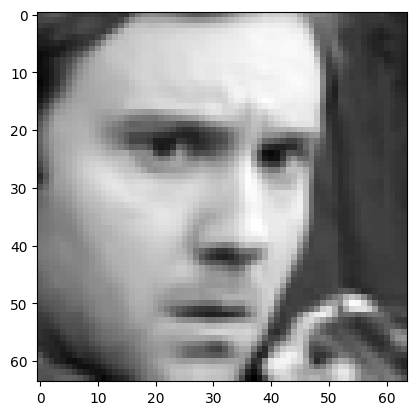

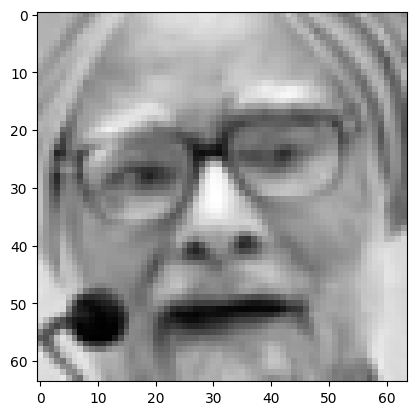

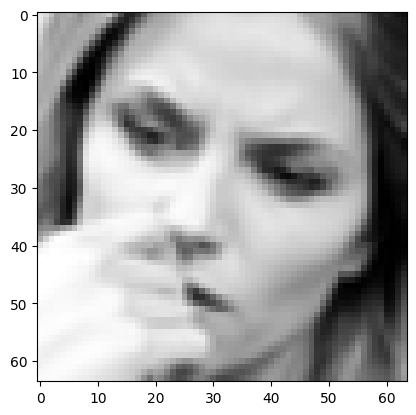

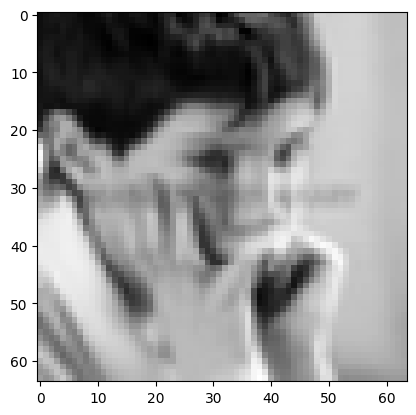

In [ ]:
for i in ds_train_faces[:4]:
  plt.imshow(np.squeeze(i),'gray')
  plt.show()

### Model Creation

In [ ]:
from keras.layers import Activation, Convolution2D, Dropout, Conv2D
from keras.layers import AveragePooling2D, BatchNormalization
from keras.layers import GlobalAveragePooling2D
from keras.models import Sequential
from keras.layers import Flatten
from keras.models import Model
from keras.layers import Input
from keras.layers import MaxPooling2D
from keras.layers import SeparableConv2D
from keras import layers
from keras.regularizers import l2
import keras
from keras.preprocessing import image

In [ ]:
def emotion_model(input_shape, classes_no):
  input_data = keras.layers.Input(input_shape)
  model = keras.layers.Convolution2D(8,(3,3))(input_data)
  model = keras.layers.BatchNormalization()(model)
  model = keras.layers.Activation('relu')(model)
  my_filters = [16,64,256,512]

  for filter in my_filters:
    model = keras.layers.Convolution2D(filter,(3,3),padding='same', kernel_regularizer=l2(4e-5))(model)
    model = keras.layers.BatchNormalization()(model)
    model = keras.layers.Activation('relu')(model)
    model = keras.layers.Convolution2D(filter,(3,3),padding='same',kernel_regularizer=l2(4e-5))(model)
    model = keras.layers.BatchNormalization()(model)
    model = keras.layers.MaxPooling2D(pool_size=(2,2), padding='same')(model)
    model = keras.layers.Activation('relu')(model)

  model = keras.layers.Convolution2D(classes_no,(3,3),padding='same', kernel_regularizer=l2(4e-5))(model)
  model = keras.layers.GlobalMaxPooling2D()(model)
  ret_model = keras.models.Model(input_data, keras.layers.Activation('softmax',name='predictions')(model))

  return ret_model

In [ ]:
from keras.callbacks import EarlyStopping
from keras.callbacks import ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator

In [ ]:
input_shape = (64,64,1)
classes_no = 7
batch_no=32


In [ ]:
#callbacks
early_stop = EarlyStopping('val_loss', patience=50)
reduce_lr = ReduceLROnPlateau('val_loss', factor=0.1, patience=int(50/4), verbose=1)
callbacks = [early_stop, reduce_lr]

In [ ]:
# data generator
data_generator = ImageDataGenerator(
                        featurewise_center=False,
                        featurewise_std_normalization=False,
                        rotation_range=10,
                        width_shift_range=0.1,
                        height_shift_range=0.1,
                        zoom_range=.1,
                        shear_range =10,
                        horizontal_flip=True)

In [ ]:
# model parameters/compilation
model=emotion_model(input_shape, classes_no)

model.compile(optimizer='adam', loss='categorical_crossentropy',metrics=['accuracy'])
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 1)]       0         
                                                                 
 conv2d (Conv2D)             (None, 62, 62, 8)         80        
                                                                 
 batch_normalization (Batch  (None, 62, 62, 8)         32        
 Normalization)                                                  
                                                                 
 activation (Activation)     (None, 62, 62, 8)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 62, 62, 16)        1168      
                                                                 
 batch_normalization_1 (Bat  (None, 62, 62, 16)        64        
 chNormalization)                                            

In [ ]:
# loading dataset
model.fit_generator(
    data_generator.flow(ds_train_faces, ds_train_emotions, batch_no),
    steps_per_epoch = len(ds_train_faces) / batch_no, epochs=200,
    verbose = 1, callbacks = callbacks, validation_data = val_data
    )

<ipython-input-20-cc9a8de5803f>:2: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model.fit_generator(


Epoch 1/200
897/897 [==============================] - 53s 41ms/step - loss: 1.8139 - accuracy: 0.3077 - val_loss: 1.7174 - val_accuracy: 0.3884 - lr: 0.0010
Epoch 2/200
897/897 [==============================] - 34s 38ms/step - loss: 1.4587 - accuracy: 0.4658 - val_loss: 1.4231 - val_accuracy: 0.4794 - lr: 0.0010
Epoch 3/200
897/897 [==============================] - 31s 34ms/step - loss: 1.3574 - accuracy: 0.5161 - val_loss: 1.2788 - val_accuracy: 0.5524 - lr: 0.0010
Epoch 4/200
897/897 [==============================] - 32s 36ms/step - loss: 1.2833 - accuracy: 0.5478 - val_loss: 1.2415 - val_accuracy: 0.5641 - lr: 0.0010
Epoch 5/200
897/897 [==============================] - 34s 38ms/step - loss: 1.2463 - accuracy: 0.5674 - val_loss: 1.3328 - val_accuracy: 0.5426 - lr: 0.0010
Epoch 6/200
897/897 [==============================] - 33s 37ms/step - loss: 1.2281 - accuracy: 0.5808 - val_loss: 1.9005 - val_accuracy: 0.4734 - lr: 0.0010
Epoch 7/200
897/897 [==============================]

In [ ]:
from keras.models import model_from_json
# serialize model to JSON
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("model.h5")


In [ ]:

# load json and create model
json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("model.h5")

In [ ]:
def detect_face(cascade, pic, scaleFactor=1.3):
  #incase we change the original one
  img=pic.copy()
  img = cv2.resize(img, (600,500))
  #convert image into gray scale as opencv face detector expects gray images
  gray_image=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  #use haar classifier to detect faces
  face_box=cascade.detectMultiScale(gray_image, scaleFactor=scaleFactor, minNeighbors=5)

  cropped=[]
  xs=[]
  ys=[]
  for(x,y,w,h) in face_box:
    cv2.rectangle(img, (x,y), (x+w, y+h+10), (0,255,0), 2)
    #crop the boxed face
    gray_frame=gray_image[y:y+h,x:x+w]
    cropped_img = cv2.resize(gray_frame, (48,48))
    cropped_img = image.img_to_array(cropped_img)
    cropped_img = cv2.resize(cropped_img.astype('uint8'), (64,64))
    cropped_img = cropped_img.astype('float32')
    cropped_img = ((cropped_img / 255.0) - 0.5) * 2.0
    cropped_img = np.expand_dims(cropped_img, 0)
    cropped_img = np.expand_dims(cropped_img,-1)
    cropped.append(cropped_img)
    xs.append(x)
    ys.append(y)



  return xs, ys, img, cropped


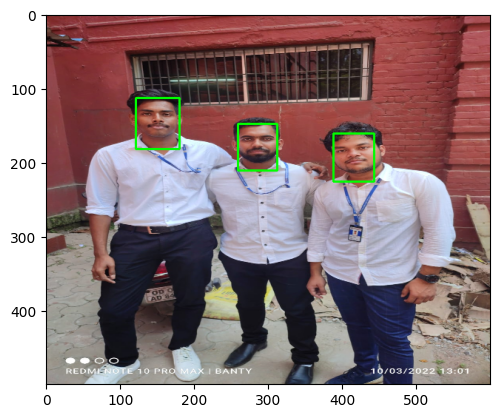

In [ ]:
emotion_lib = {0: "Angry", 1: "Disgusted", 2: "Fearful", 3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"}
test_image=cv2.imread('/content/tom.jpg')

cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

x, y, face, crop=detect_face(cascade, test_image)
plt.imshow(cv2.cvtColor(face, cv2.COLOR_BGR2RGB))

1/1 [==============================] - 0s 17ms/step


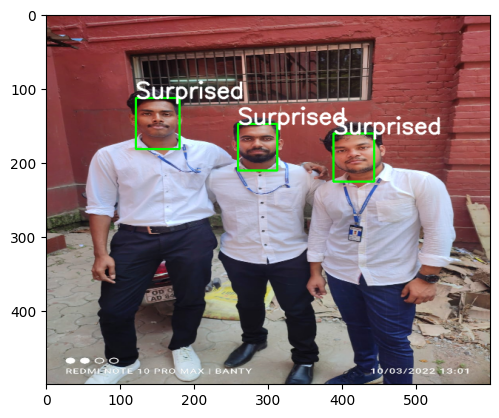

In [ ]:
j=0
for i in crop:
  emotion_pred=int(np.argmax(loaded_model.predict(i)))
  cv2.putText (face, emotion_lib[emotion_pred], (x[j], y[j]), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
  j+=1

plt.imshow(cv2.cvtColor(face, cv2.COLOR_BGR2RGB))

In [ ]:
emotion_lib = {0: "Angry", 1: "Disgusted", 2: "Fearful", 3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"}
test_image=cv2.imread('/content/tom.jpg')

cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
x, y, face, crop=detect_face(cascade, test_image)

j=0
for i in crop:
  emotion_pred=int(np.argmax(loaded_model.predict(i)))
  cv2.putText (face, emotion_lib[emotion_pred], (x[j], y[j]), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
  j+=1

plt.imshow(cv2.cvtColor(face, cv2.COLOR_BGR2RGB))

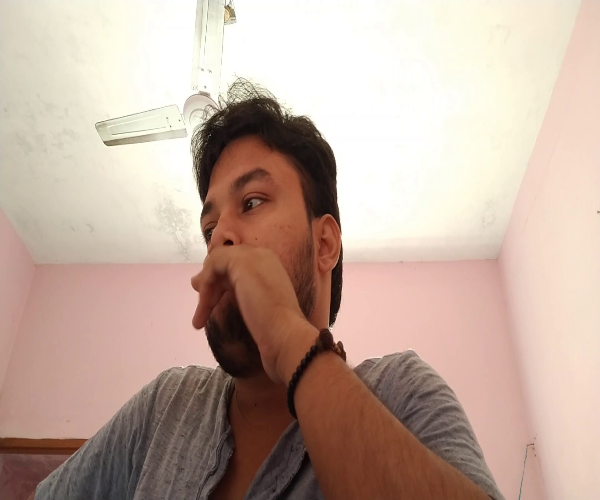

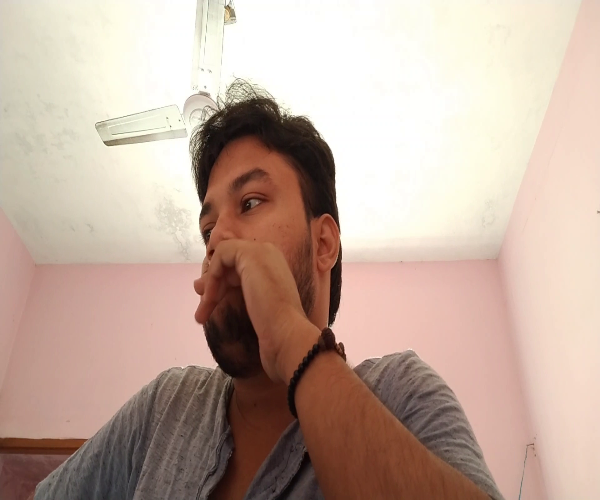

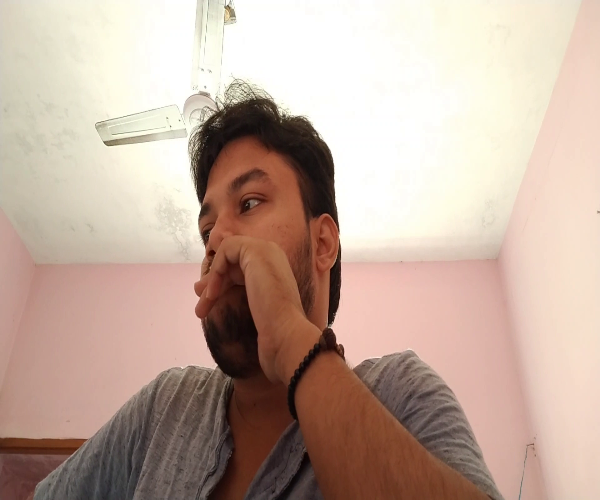

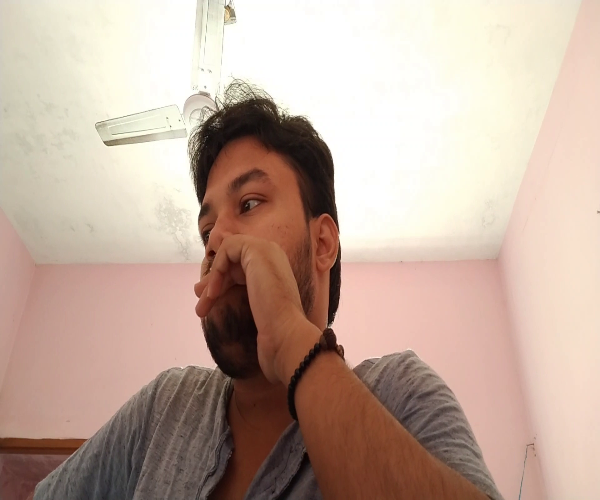

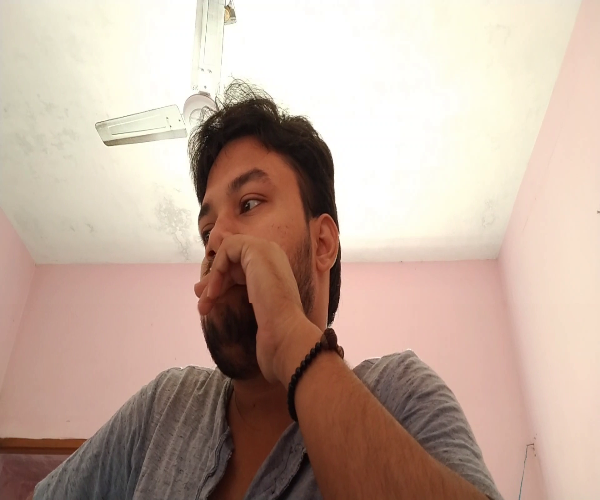

...

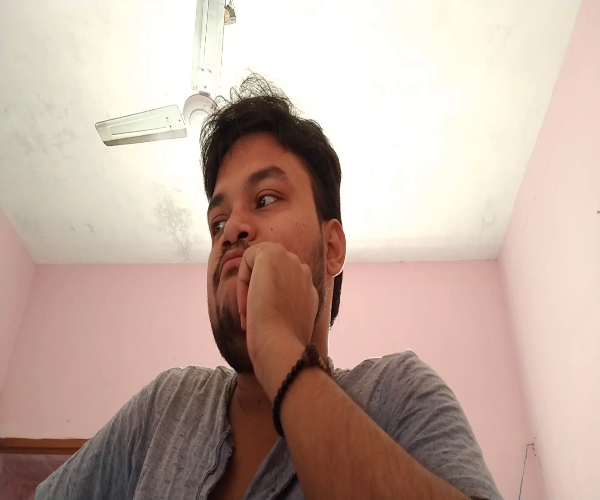

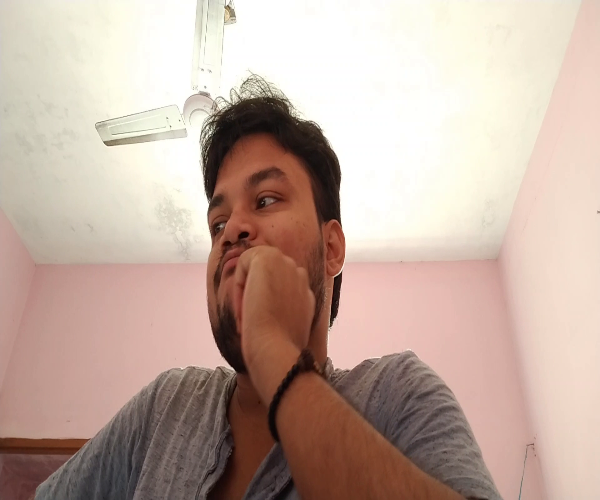

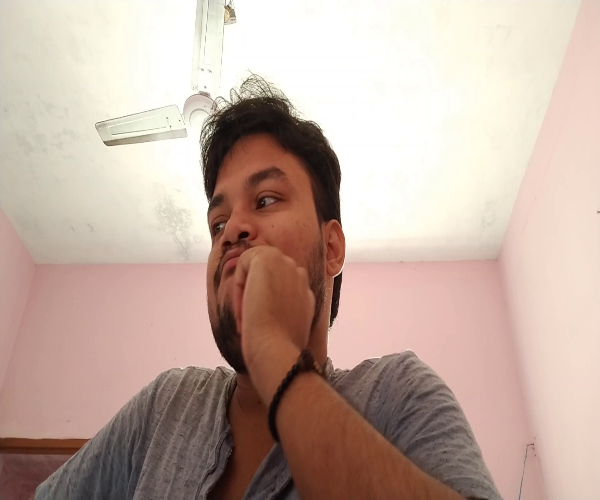

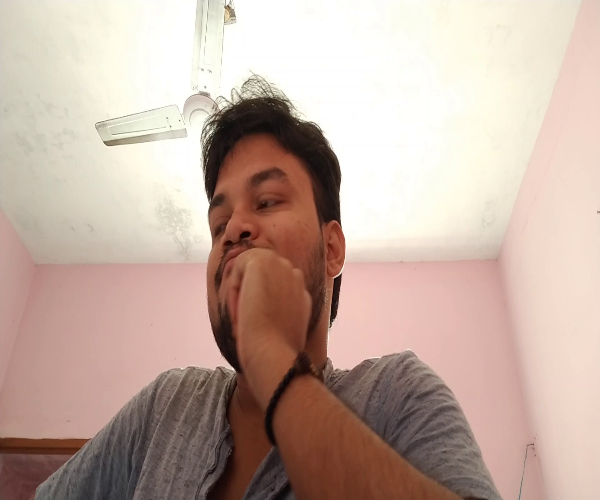

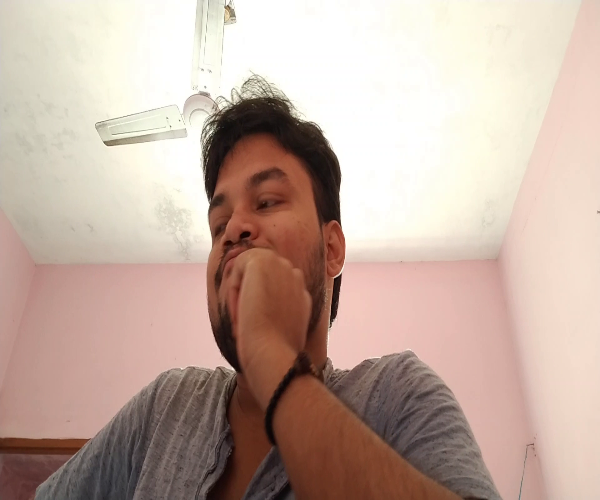

1/1 [==============================] - 0s 65ms/step


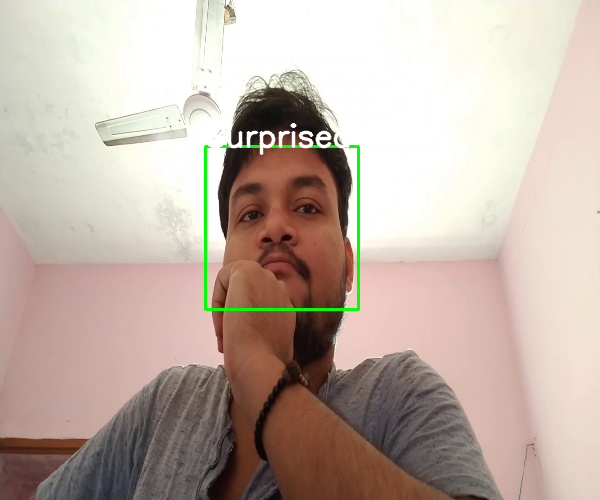

1/1 [==============================] - 0s 64ms/step


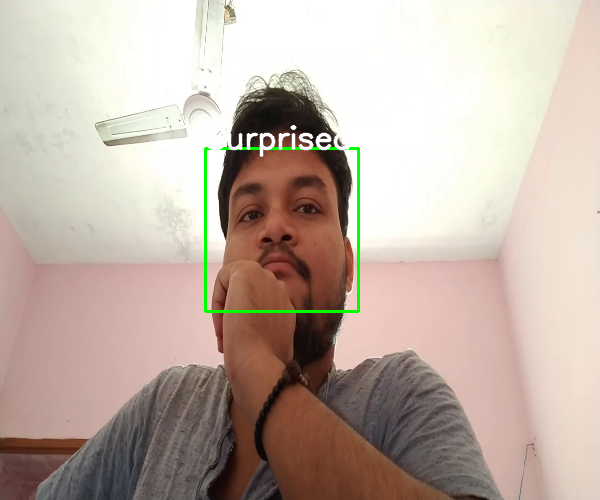

1/1 [==============================] - 0s 37ms/step


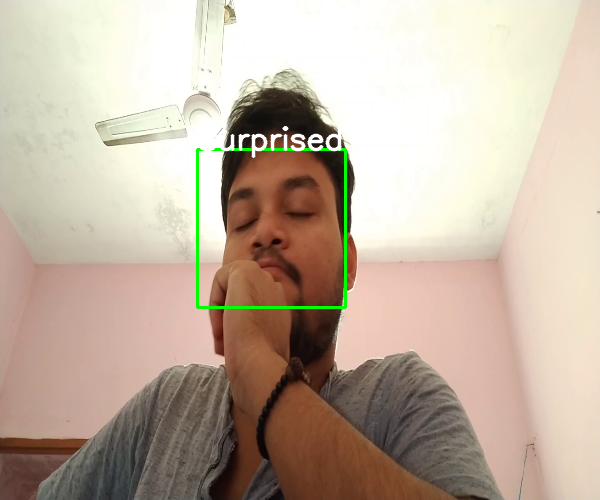

1/1 [==============================] - 0s 45ms/step


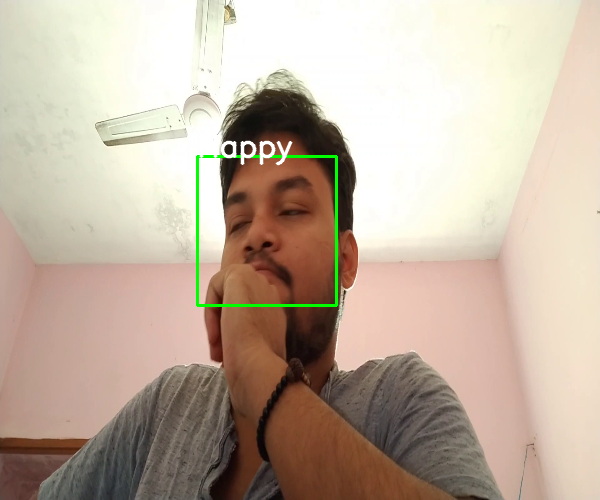

1/1 [==============================] - 0s 26ms/step


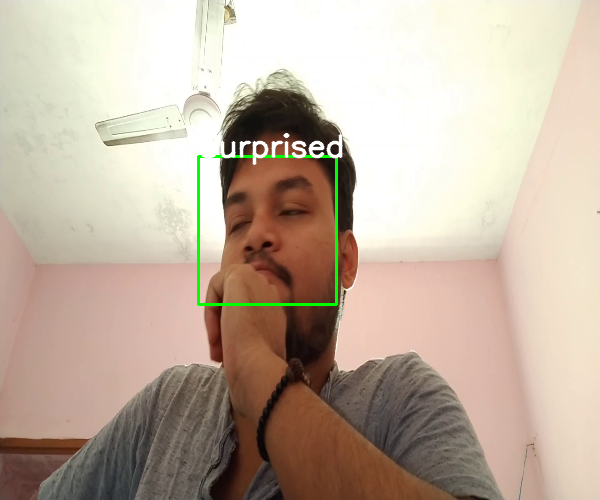

1/1 [==============================] - 0s 26ms/step


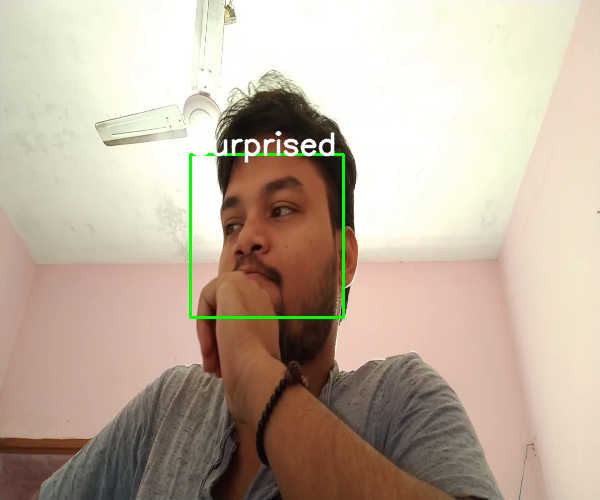

1/1 [==============================] - 0s 33ms/step


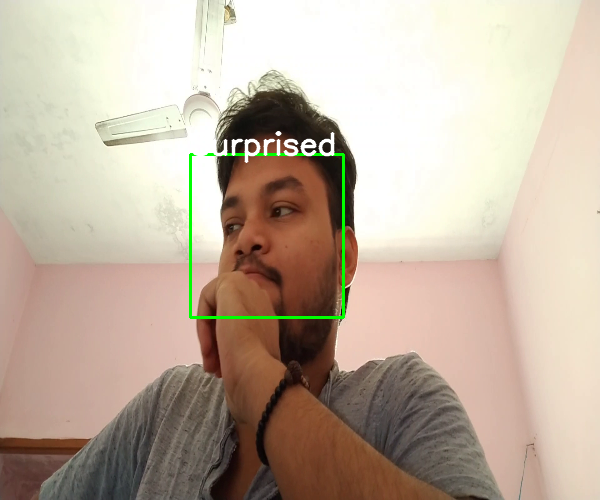

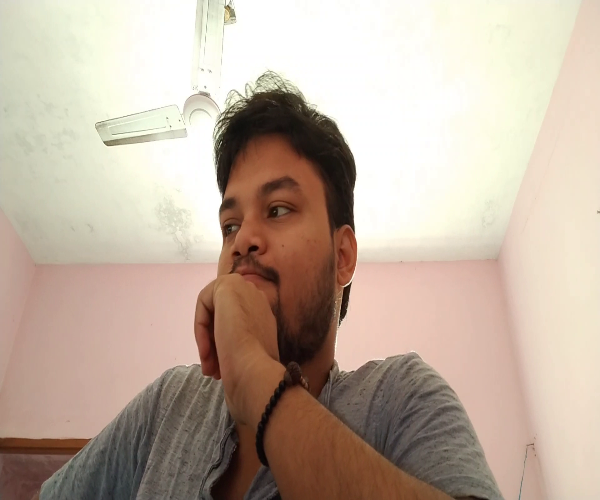

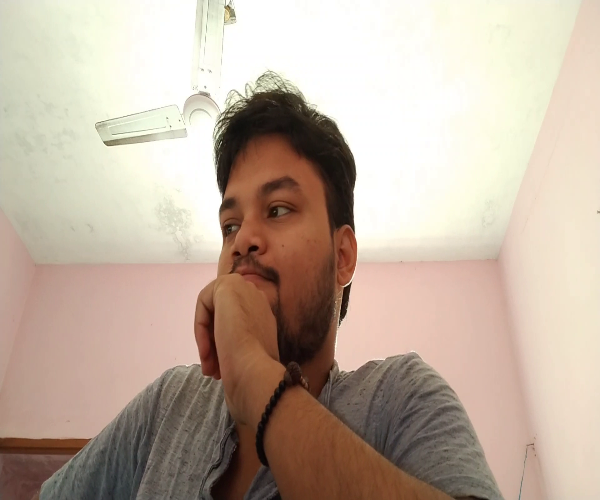

1/1 [==============================] - 0s 36ms/step


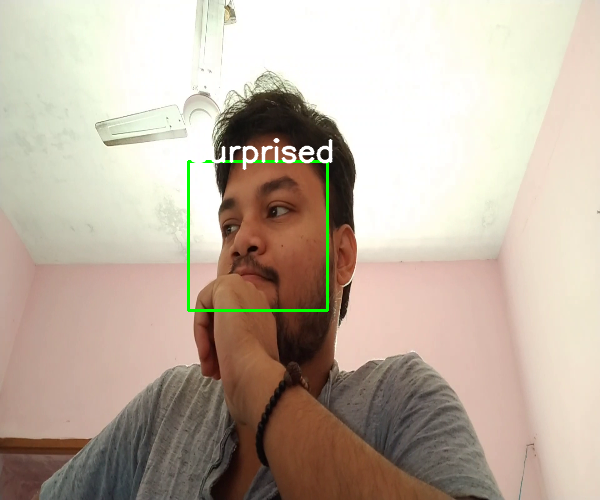

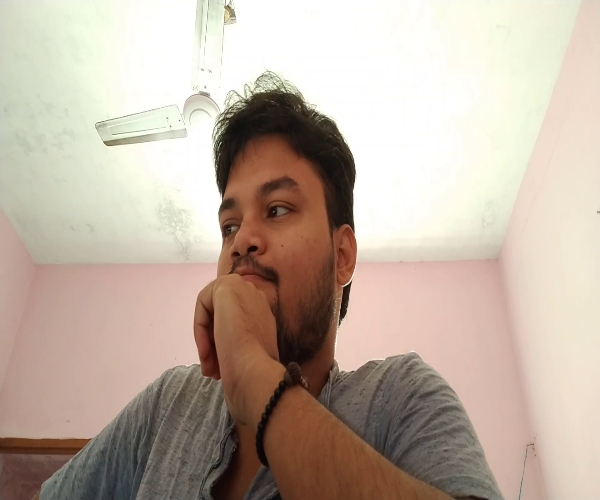

1/1 [==============================] - 0s 53ms/step


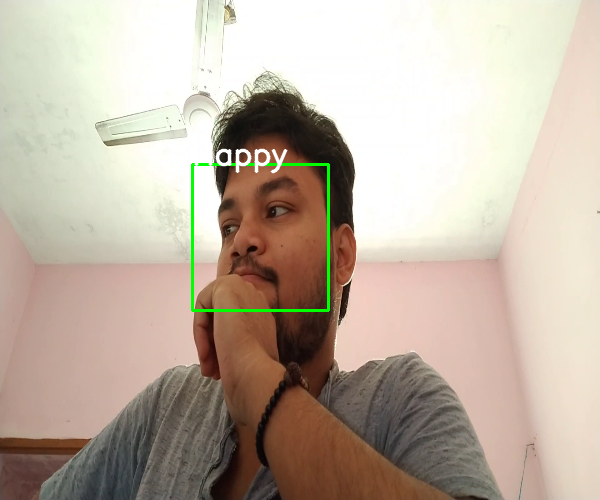

1/1 [==============================] - 0s 42ms/step


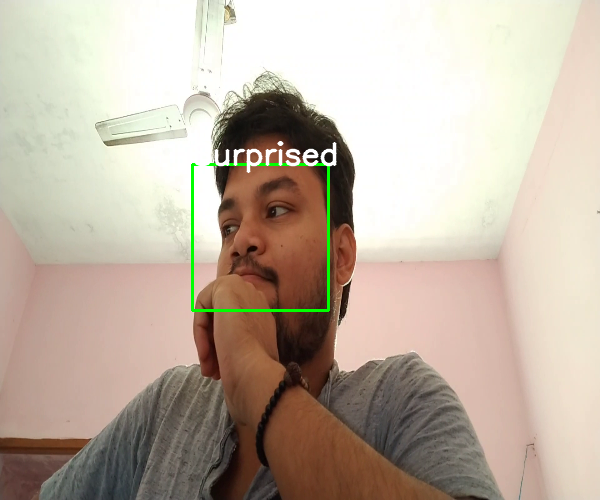

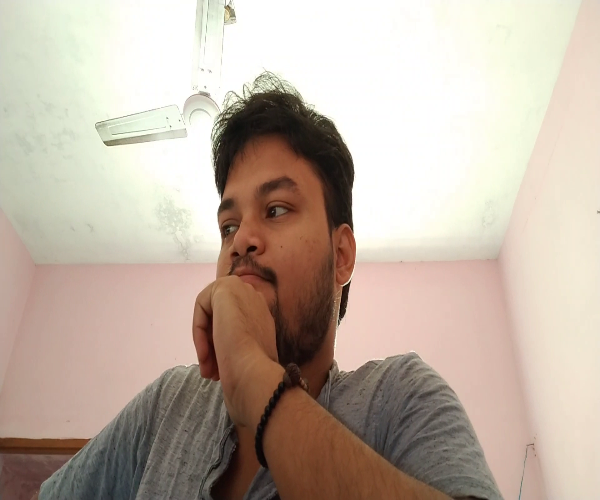

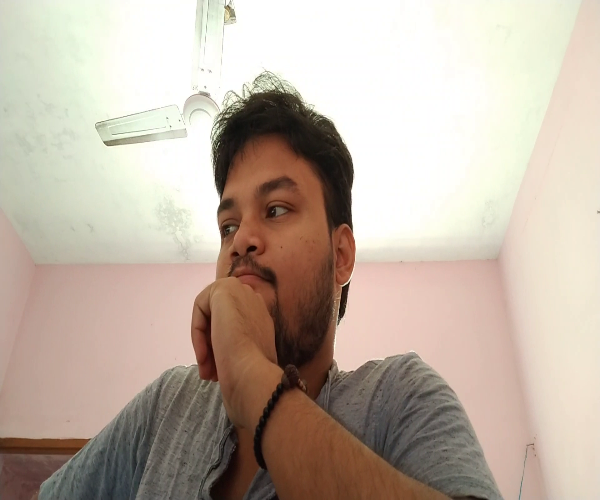

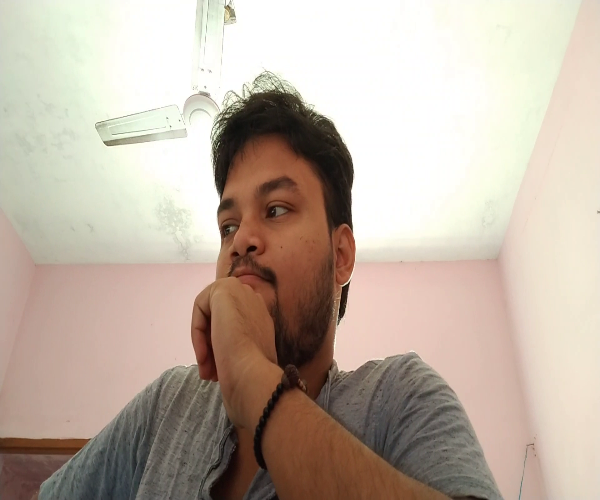

1/1 [==============================] - 0s 28ms/step


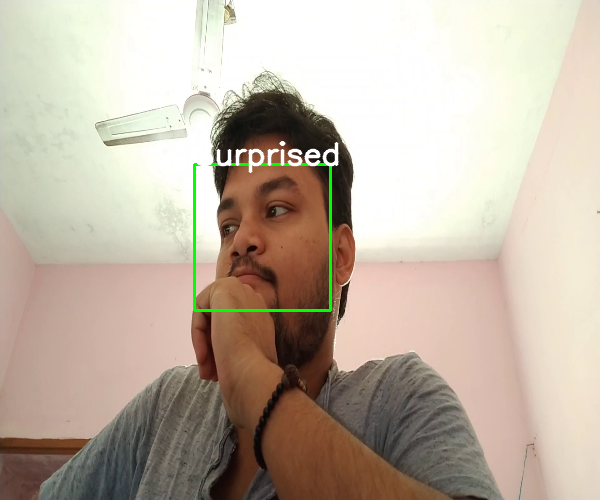

1/1 [==============================] - 0s 26ms/step


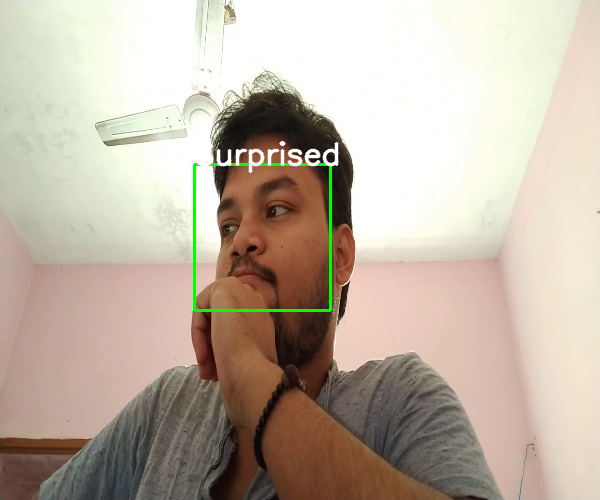

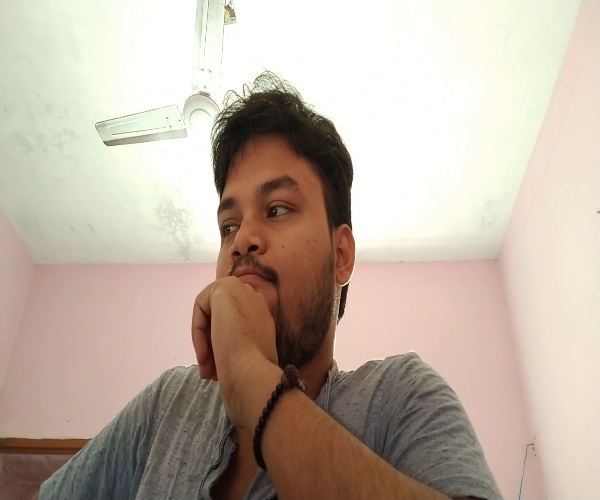

1/1 [==============================] - 0s 28ms/step


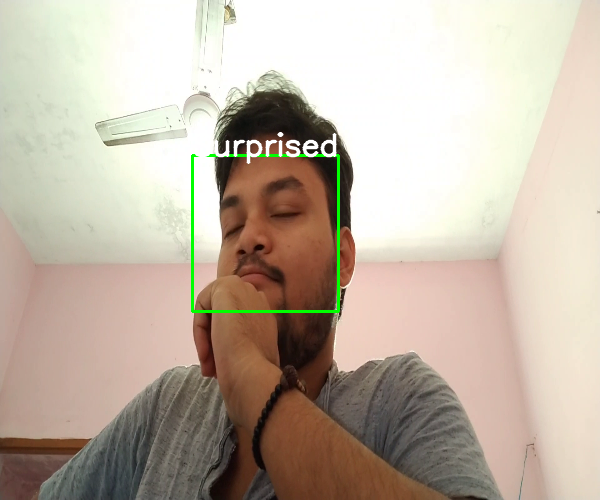

1/1 [==============================] - 0s 25ms/step


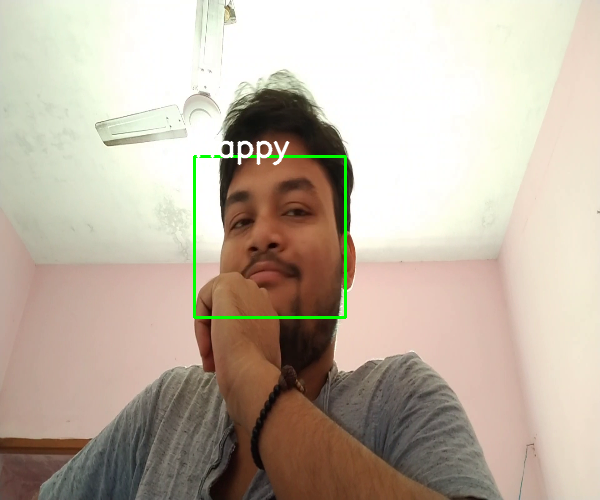

1/1 [==============================] - 0s 27ms/step


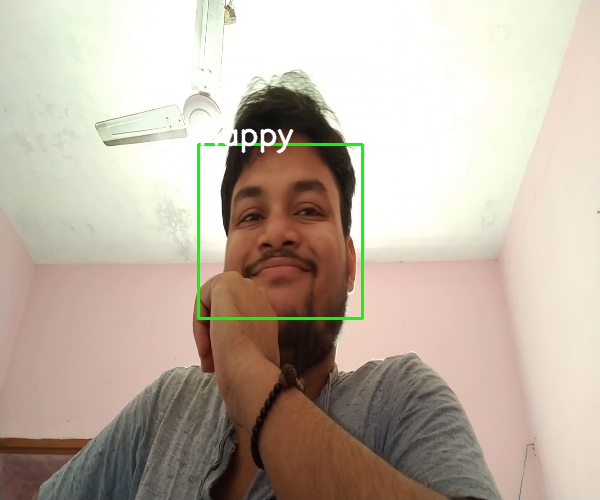

1/1 [==============================] - 0s 25ms/step


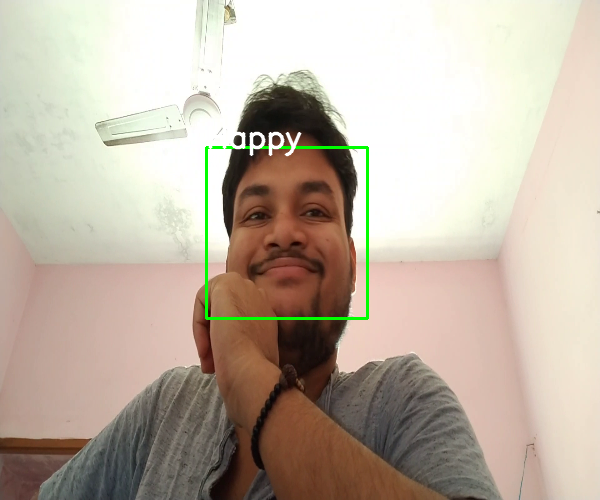

1/1 [==============================] - 0s 27ms/step


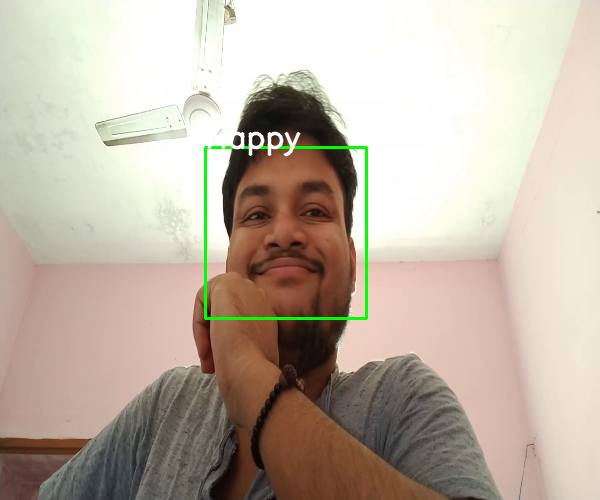

1/1 [==============================] - 0s 27ms/step


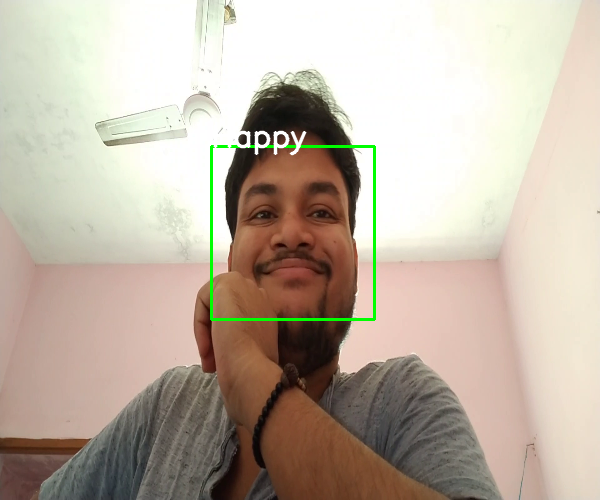

1/1 [==============================] - 0s 28ms/step


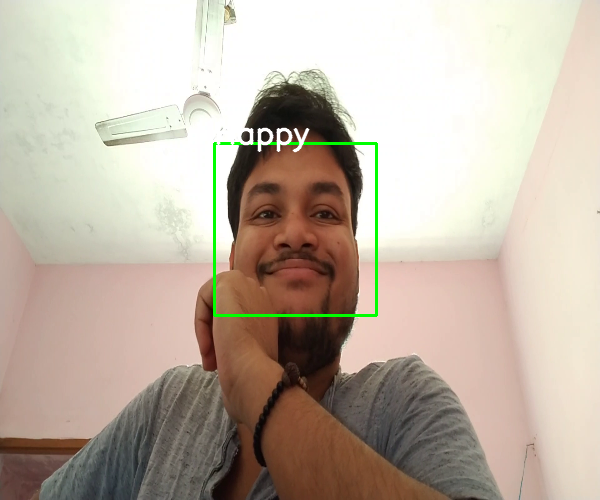

1/1 [==============================] - 0s 27ms/step


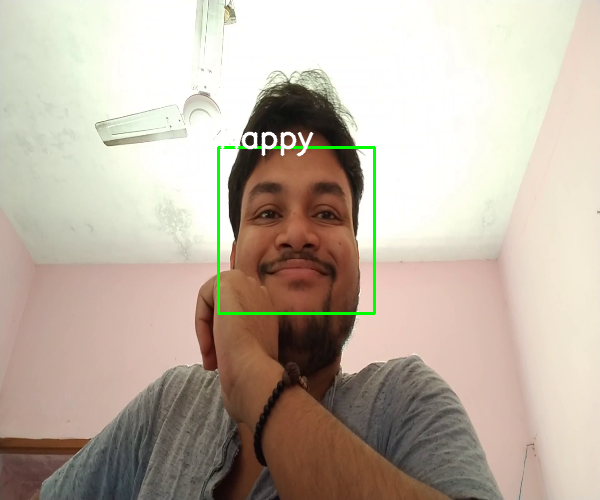

1/1 [==============================] - 0s 26ms/step


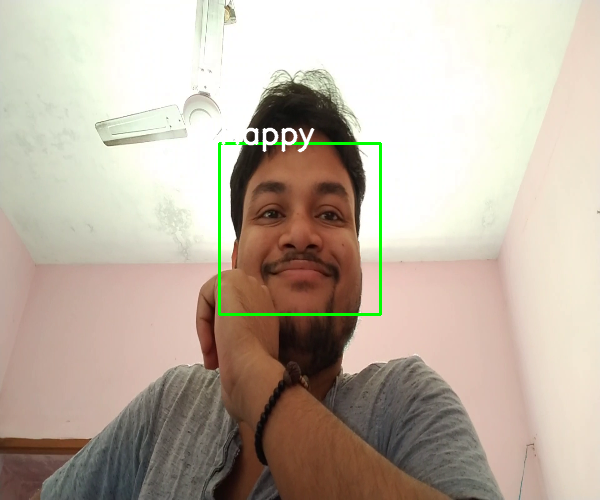

1/1 [==============================] - 0s 26ms/step


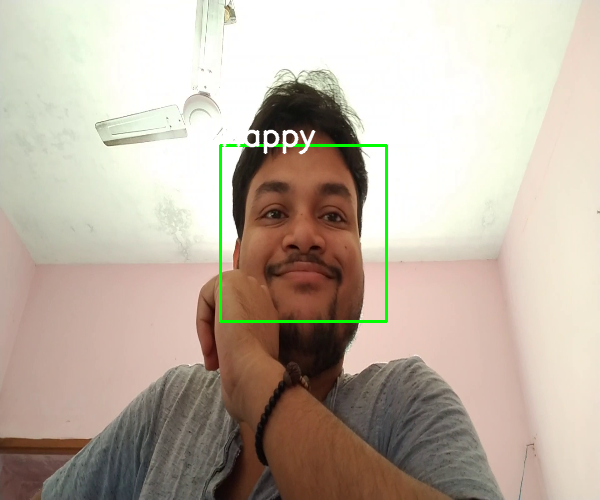

1/1 [==============================] - 0s 26ms/step


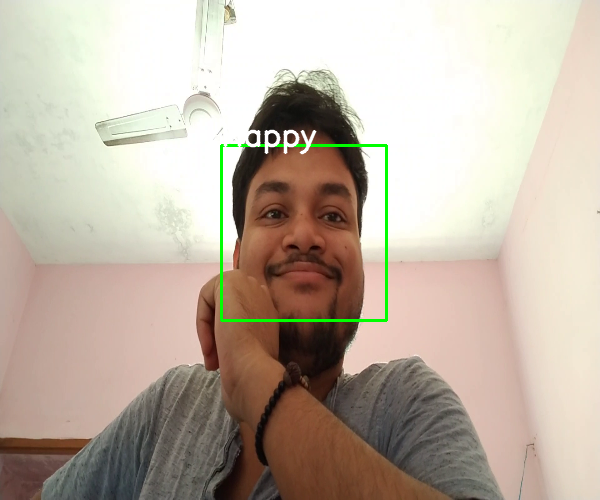

1/1 [==============================] - 0s 28ms/step


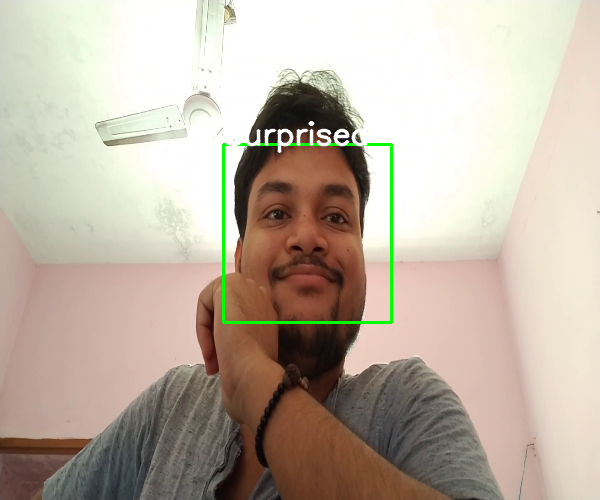

1/1 [==============================] - 0s 25ms/step


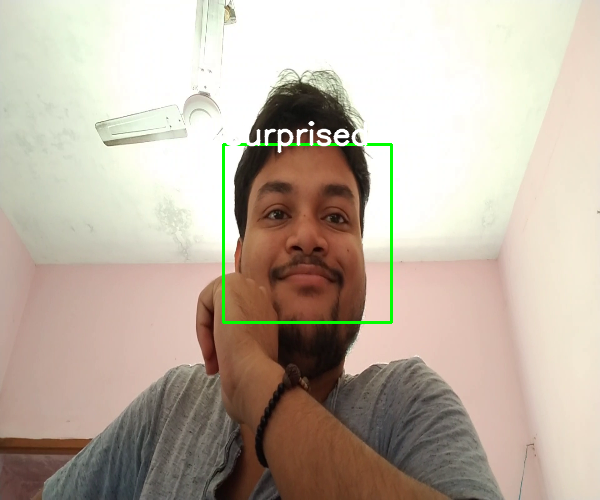

1/1 [==============================] - 0s 26ms/step


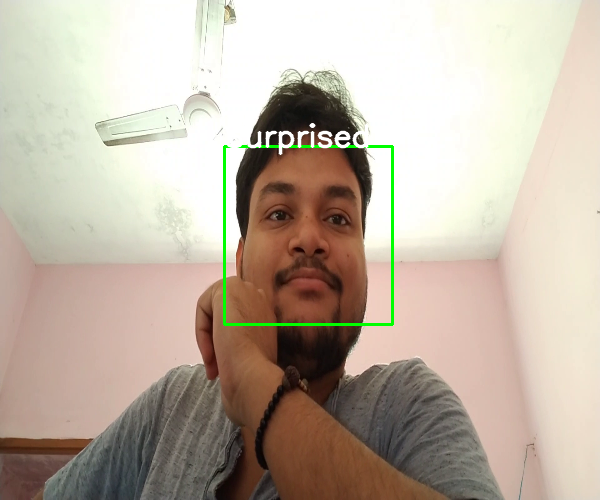

1/1 [==============================] - 0s 26ms/step


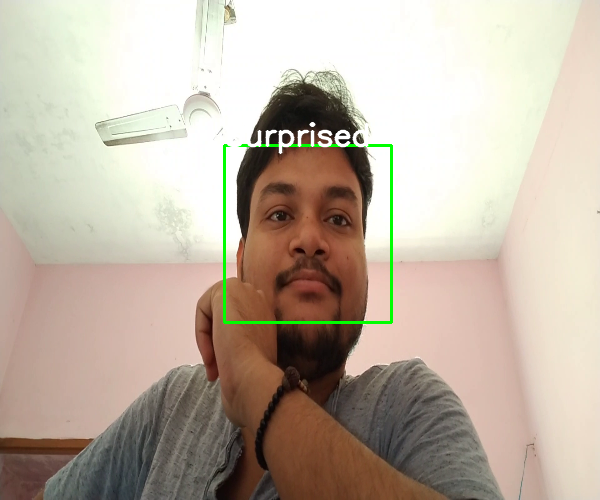

1/1 [==============================] - 0s 32ms/step


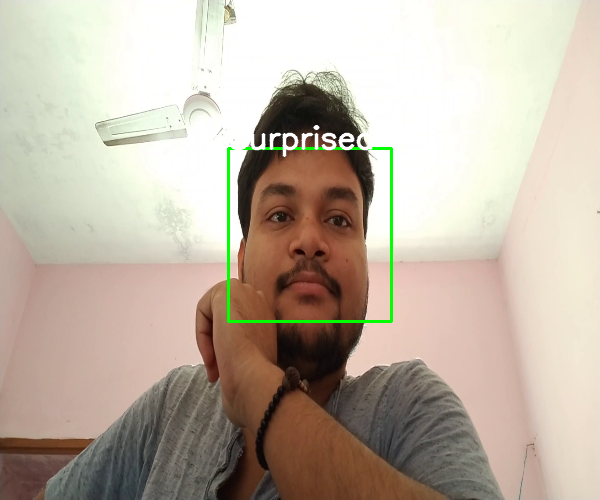

1/1 [==============================] - 0s 26ms/step


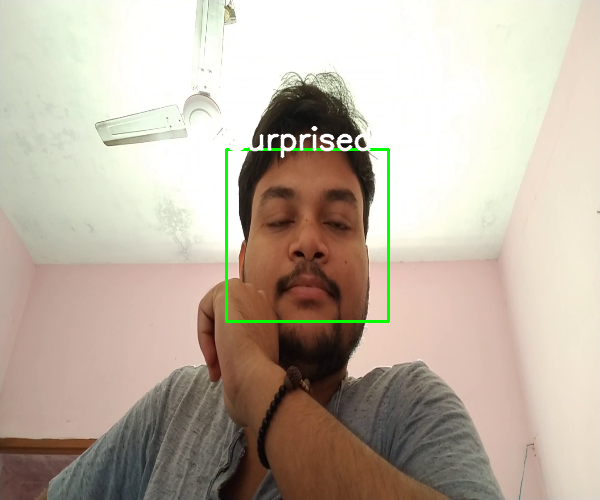

1/1 [==============================] - 0s 26ms/step


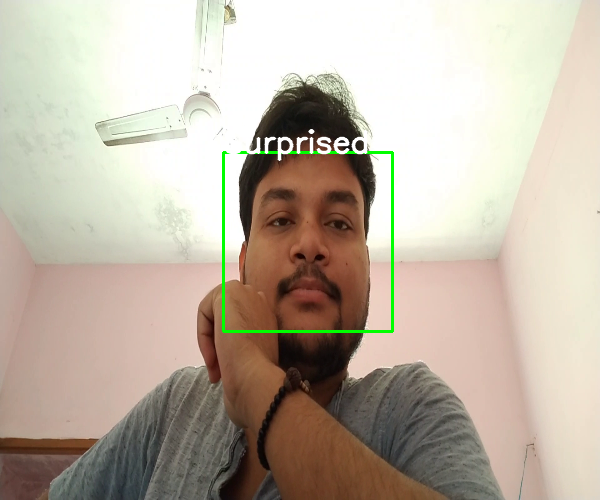

1/1 [==============================] - 0s 28ms/step


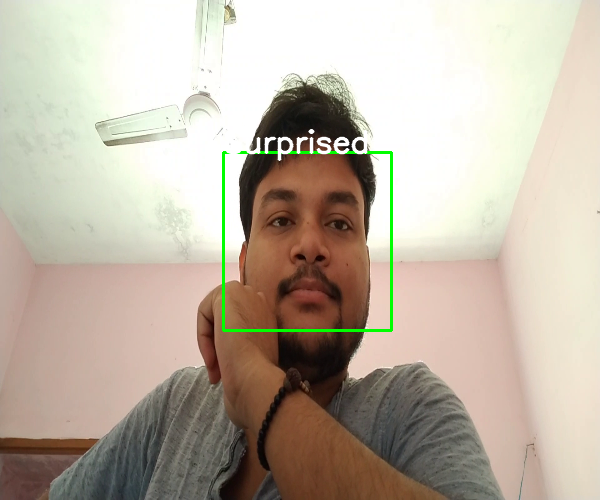

1/1 [==============================] - 0s 30ms/step


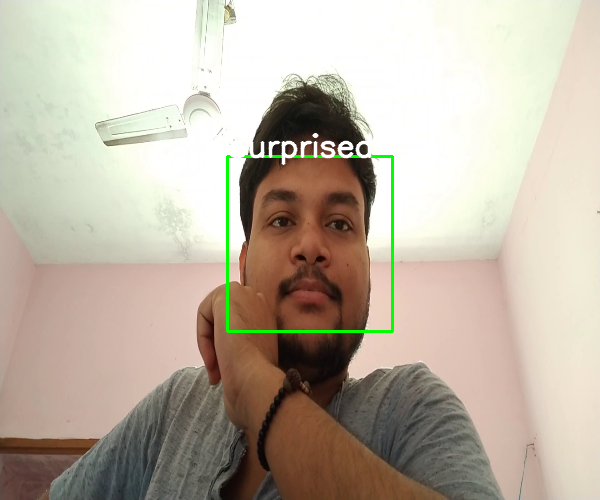

1/1 [==============================] - 0s 26ms/step


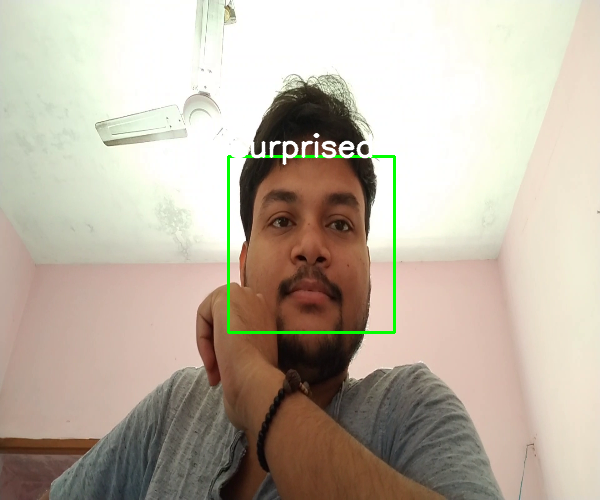

1/1 [==============================] - 0s 26ms/step


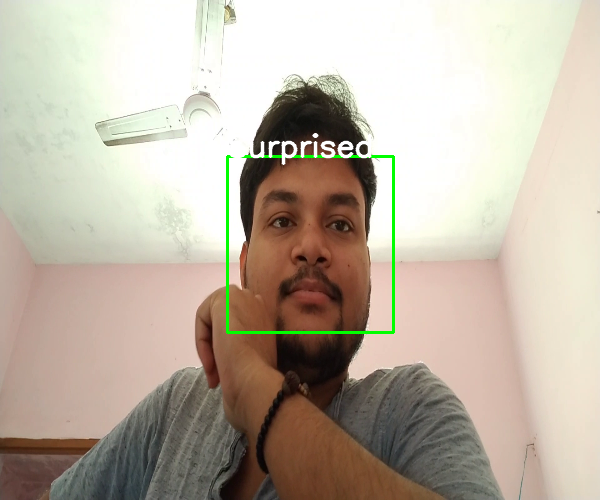

1/1 [==============================] - 0s 25ms/step


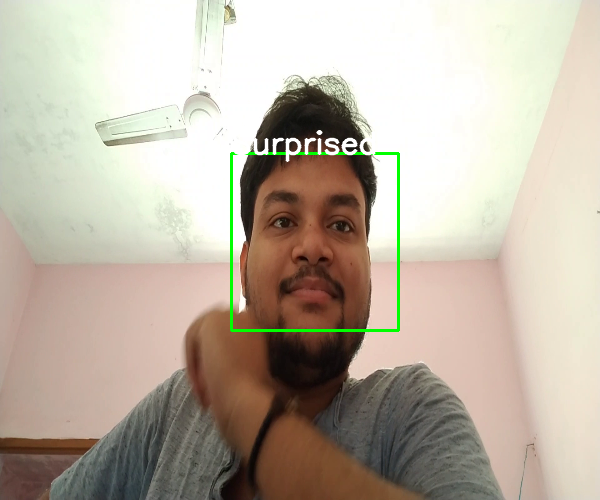

1/1 [==============================] - 0s 26ms/step


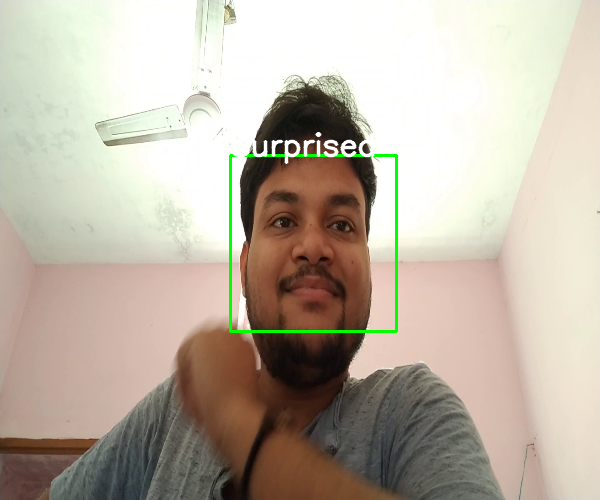

1/1 [==============================] - 0s 27ms/step


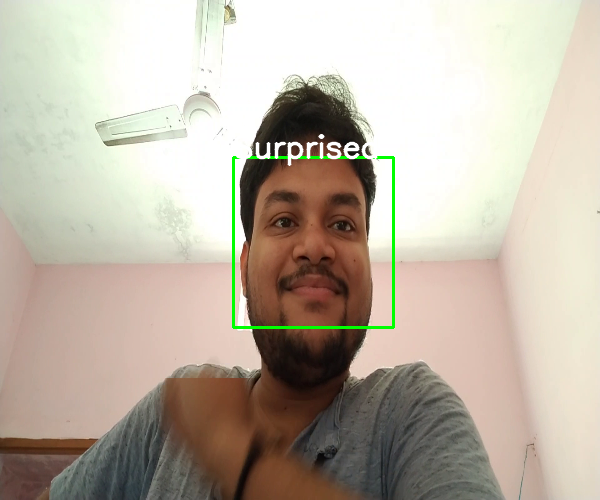

1/1 [==============================] - 0s 28ms/step


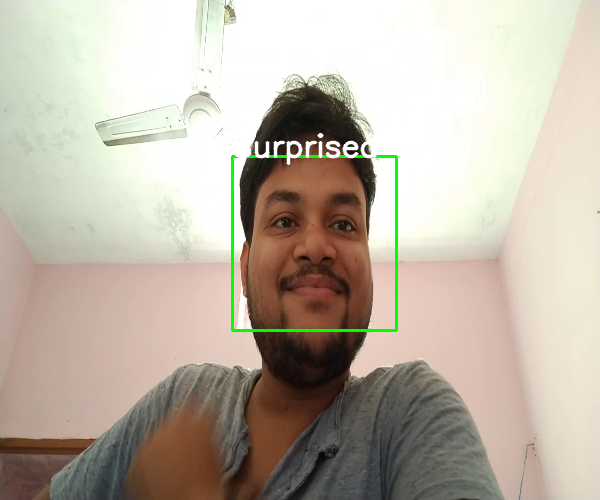

1/1 [==============================] - 0s 42ms/step


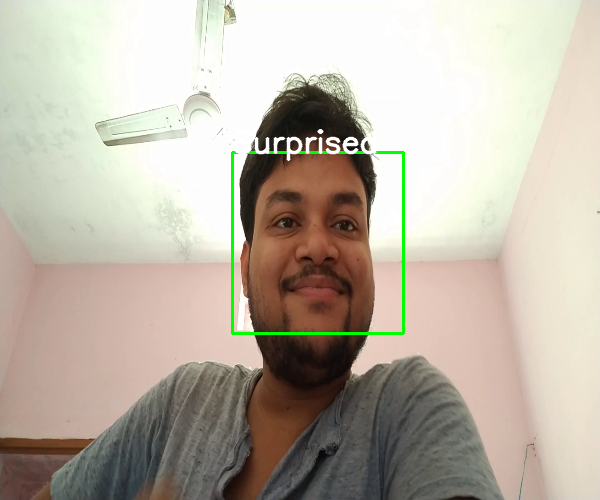

1/1 [==============================] - 0s 31ms/step


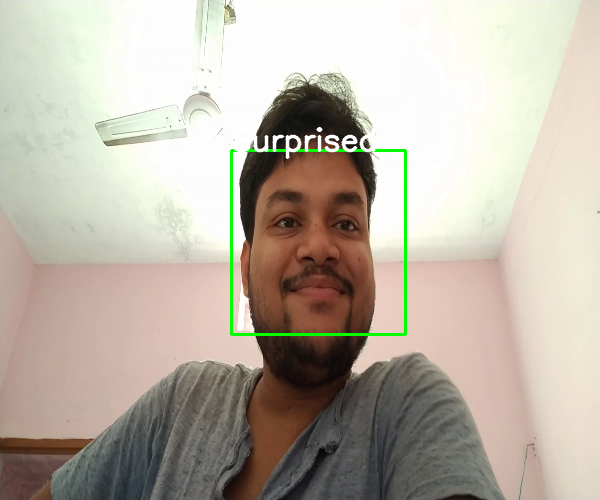

1/1 [==============================] - 0s 63ms/step


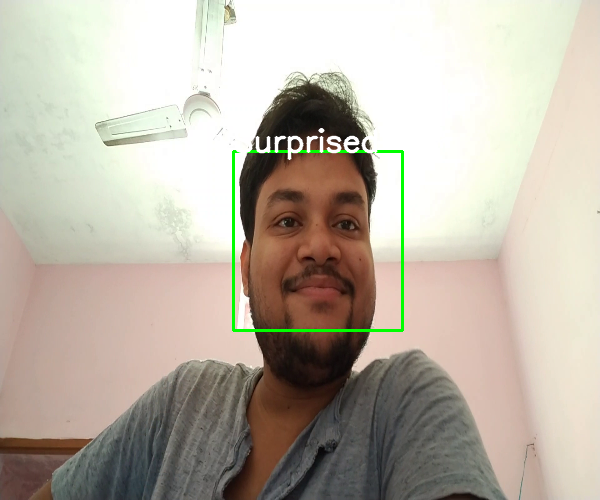

1/1 [==============================] - 0s 42ms/step


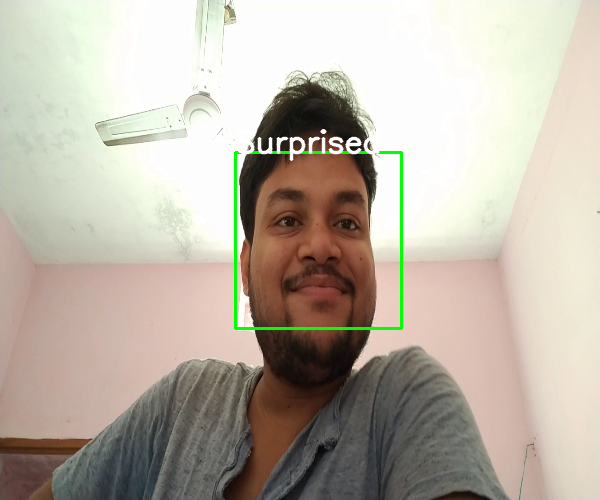

1/1 [==============================] - 0s 69ms/step


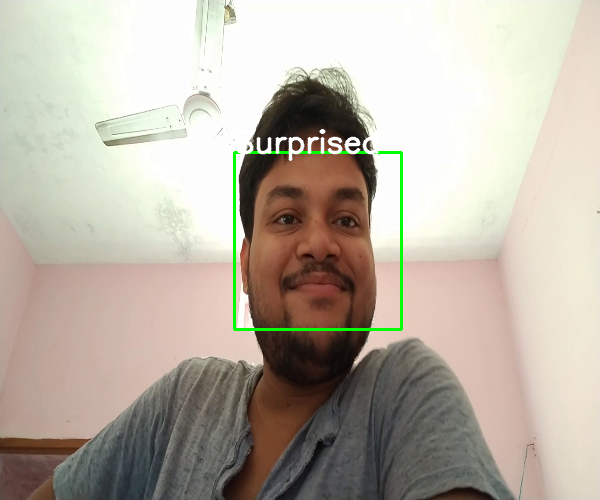

1/1 [==============================] - 0s 26ms/step


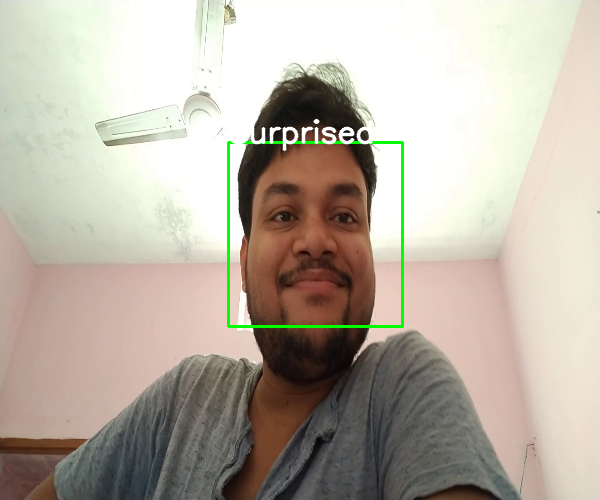

1/1 [==============================] - 0s 35ms/step


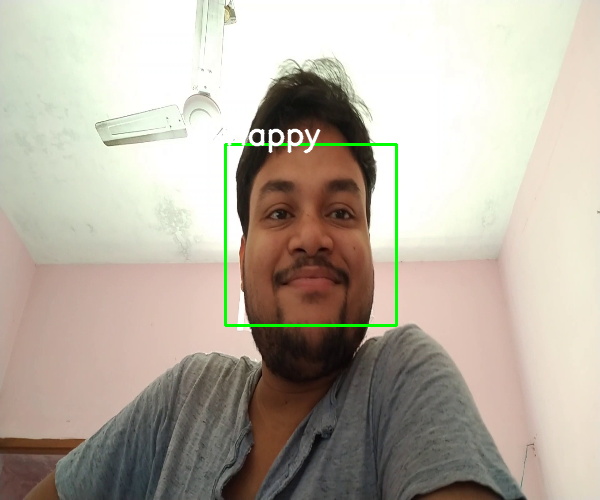

1/1 [==============================] - 0s 62ms/step


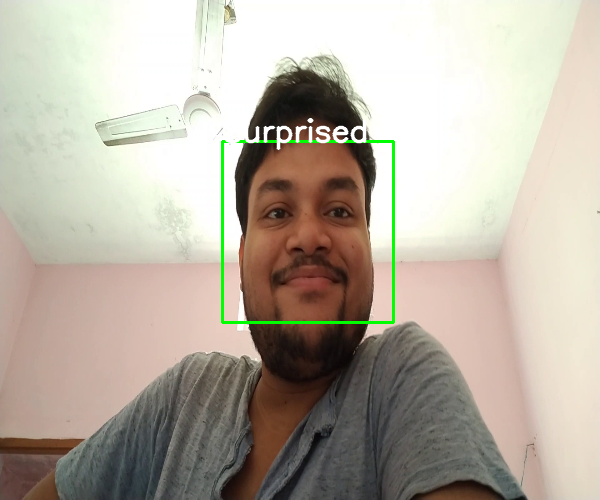

1/1 [==============================] - 0s 61ms/step


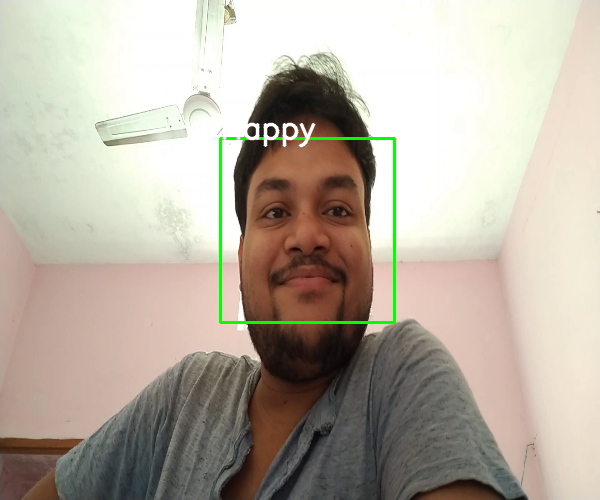

1/1 [==============================] - 0s 26ms/step


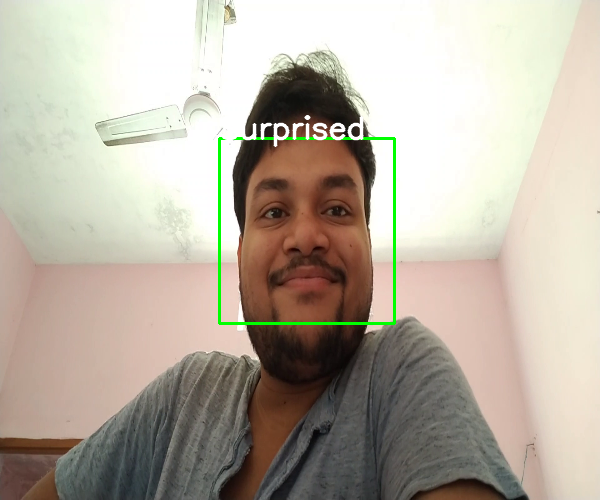

1/1 [==============================] - 0s 27ms/step


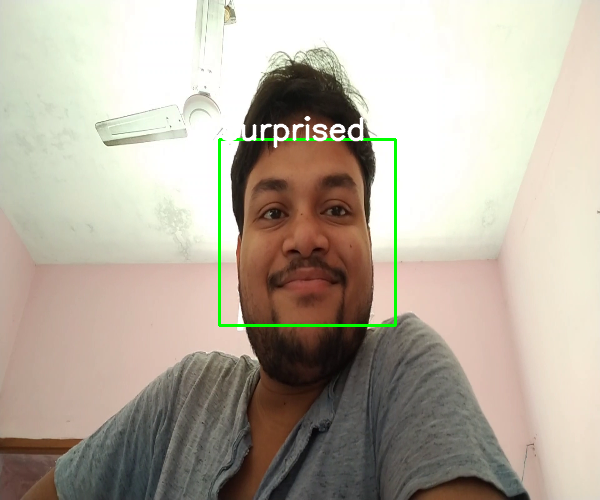

1/1 [==============================] - 0s 46ms/step


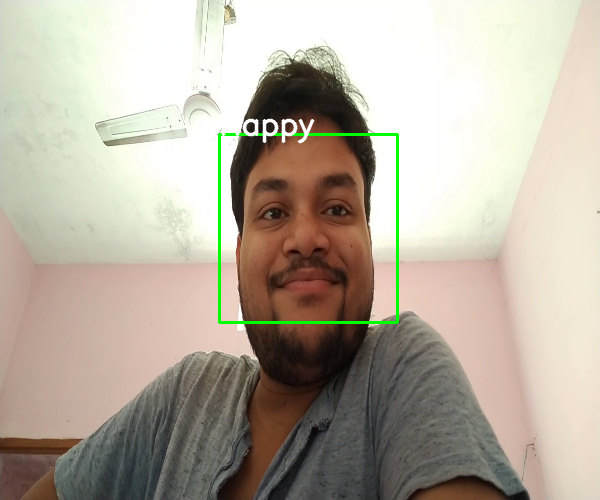

1/1 [==============================] - 0s 30ms/step


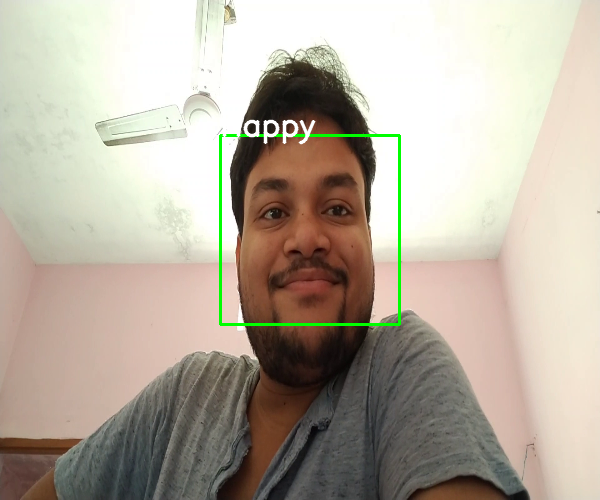

1/1 [==============================] - 0s 28ms/step


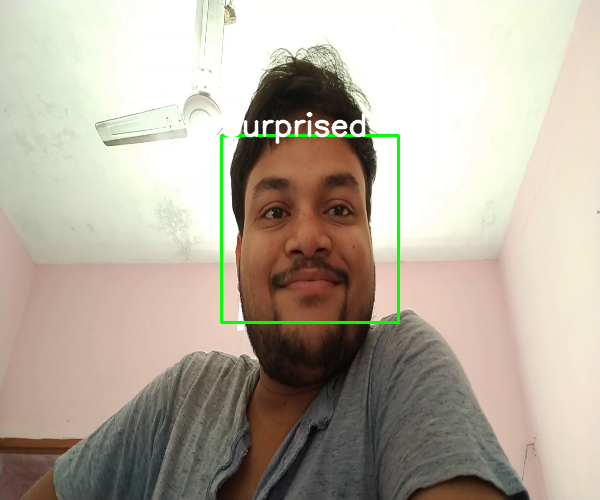

1/1 [==============================] - 0s 26ms/step


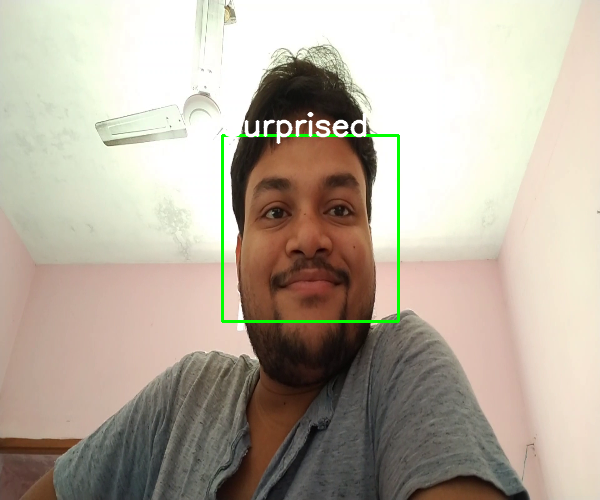

1/1 [==============================] - 0s 38ms/step


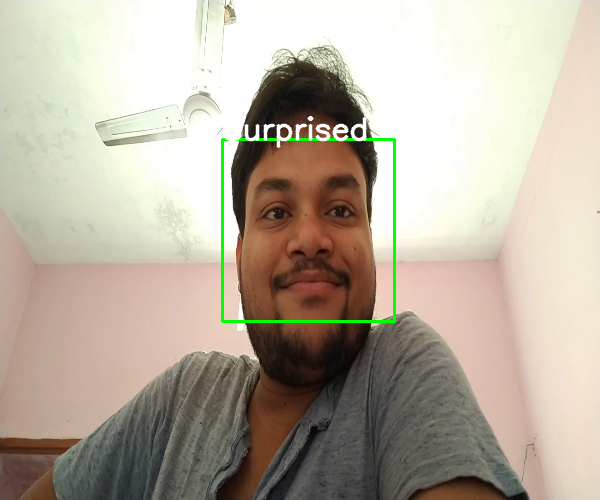

1/1 [==============================] - 0s 31ms/step


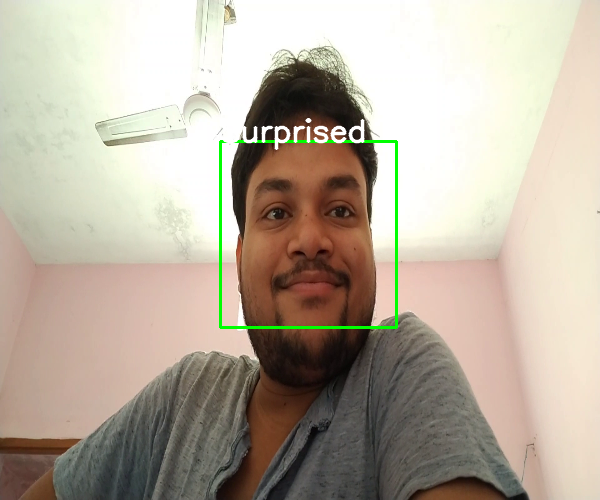

1/1 [==============================] - 0s 26ms/step


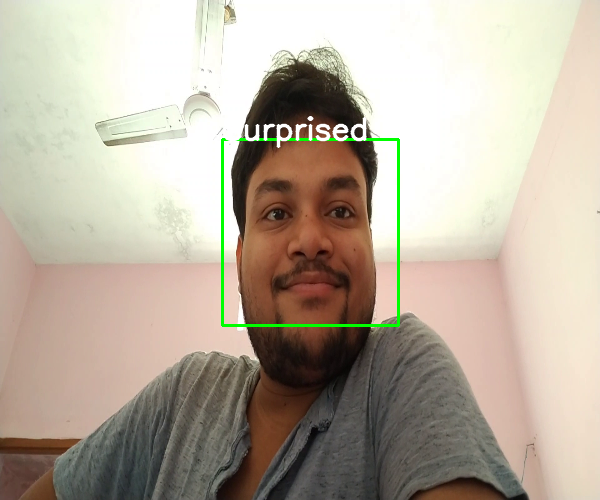

1/1 [==============================] - 0s 45ms/step


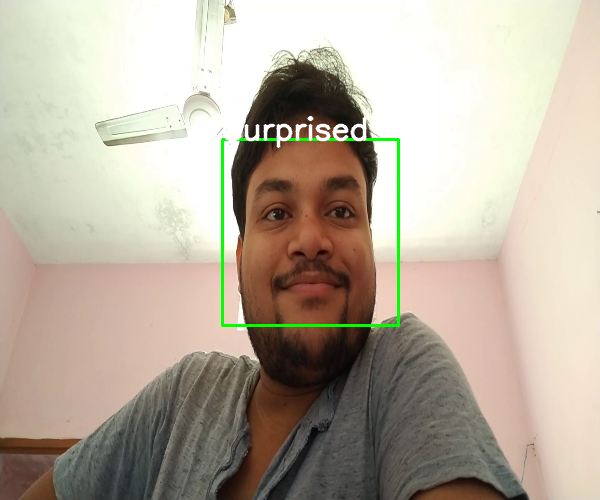

1/1 [==============================] - 0s 54ms/step


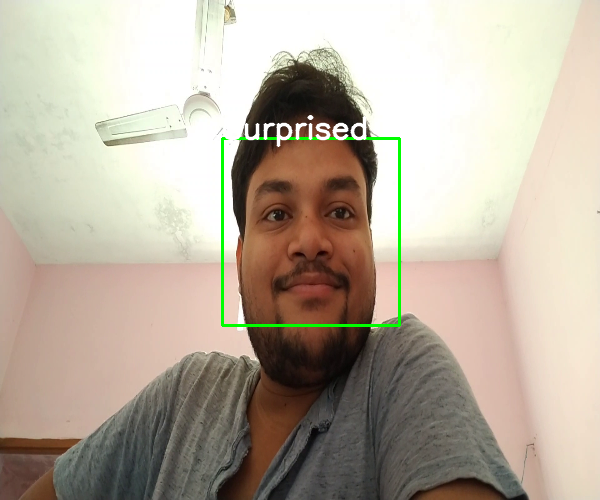

1/1 [==============================] - 0s 26ms/step


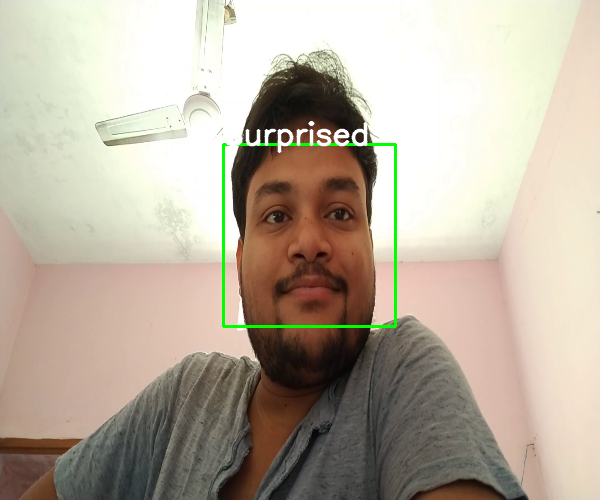

1/1 [==============================] - 0s 28ms/step


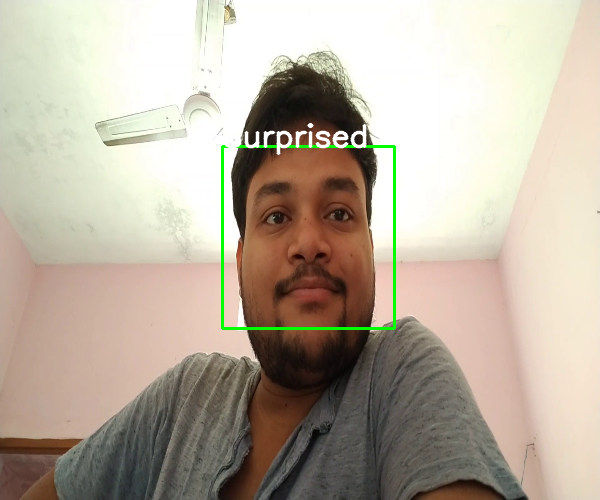

1/1 [==============================] - ETA: 0s

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Define the emotion labels
emotion_lib = {0: "Angry", 1: "Disgusted", 2: "Fearful", 3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"}

# Load the pre-trained face cascade
cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Load the pre-trained emotion detection model (loaded_model) and any other necessary components

# Capture video from your webcam or video file
cap = cv2.VideoCapture("/content/vom.mp4")  # Replace with the path to your video file

while True:
    # Read a frame from the video
    ret, frame = cap.read()

    if not ret:
        break

    # Detect faces in the frame
    x, y, face, crop = detect_face(cascade, frame)

    # Process each cropped face
    j = 0
    for i in crop:
        emotion_pred = int(np.argmax(loaded_model.predict(i)))
        cv2.putText(face, emotion_lib[emotion_pred], (x[j], y[j]), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        j += 1

    # Display the frame with annotations
    cv2_imshow(face)

    # Exit on 'q' key press
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video capture and close the windows
cap.release()
cv2.destroyAllWindows()

In [ ]:
import zipfile

# List of files you want to zip
files_to_zip = ['/content/model.h5', '/content/model.json', '/content/dataset/fer2013/fer2013.csv', "/content/tom.jpg"]

# Create a zip file
with zipfile.ZipFile('Face_emotion.zip', 'w') as zipf:
    for file in files_to_zip:
        zipf.write(file)

In [ ]:
!cp Face_emotion.zip /content/drive/MyDrive/